## Dependances

In [1]:
import cv2 
import argparse
import sys
import os
import json
import time
import random
import datetime
import argparse
import numpy as np
from torch.utils.data import Dataset
from PIL import Image
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader
import pandas as pd


import datasets
import util.misc as utils
from models import build_model
import datasets.transforms as T
from torchvision.transforms import v2
from datasets import build_dataset
from engine import evaluate, train_one_epoch
from pathlib import Path
from torchsampler import ImbalancedDatasetSampler
from PIL import Image
from IPython.display import clear_output

# Local dep
project_dir = '/data/konrad/workspace'
sys.path.insert(0, project_dir)

from helpers.datasets import CalfFaceDataset
from helpers.helpers import get_indices, load_face_data, uniform_sample_with_values
from helpers.trainers import plot_metrics


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Utilitaires

In [2]:
class CalfCenterFaceDataset(Dataset):
    # def __init__(self, df, image_dir, bbox_size = 800, transform=None):
    def __init__(self, df, bbox_size = 800, transform=None):
        self.data_frame = df
        self.transform = transform
        # self.image_dir = image_dir
        self.bbox_size = bbox_size
        self.labels = self.data_frame["target"]
        
        label_to_count = self.labels.value_counts()

        weights = 1.0 / label_to_count[self.labels]

        self.weights = torch.DoubleTensor(weights.to_list())
        
    def __len__(self):
        return len(self.data_frame)

    def __getitem__(self, idx):
        row = self.data_frame.loc[idx]
        img_path = self.data_frame.loc[idx, "path"]  
        # img_path = self.image_dir + '/' + img_name
        image = Image.open(img_path)
        label = self.data_frame.loc[idx, "target"]

        xmin = row['x_min']
        ymin = row['y_min']
        xmax = row['x_max']
        ymax = row['y_max']
        
        # Calculate the width and height of the bounding box
        bbox_width = xmax - xmin
        bbox_height = ymax - ymin
        
        # Calculate the center of the first bounding box
        center_x = xmin + bbox_width / 2
        center_y = ymin + bbox_height / 2
        
        # Define the width and height of the second bounding box
        second_bbox_width = self.bbox_size
        second_bbox_height = self.bbox_size
        
        # Calculate the top-left corner of the second bounding box
        second_xmin = center_x - second_bbox_width / 2
        second_ymin = center_y - second_bbox_height / 2

        # Open the image

        # Crop the first bounding box from the image
        bbox_cropped_image = image.crop((xmin, ymin, xmax, ymax))
        
        # Resize the first cropped image to 800x800
        # first_resized_image = first_cropped_image.resize((self.bbox_size, self.bbox_size))
        
        # Crop the second bounding box from the image
        # img = Image.fromarray(img.cpu().permute(1, 2, 0).numpy())
        image = image.crop((second_xmin, second_ymin, second_xmin + second_bbox_width, second_ymin + second_bbox_height))

        # img = v2.ToTensor()(img)
        image = v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])(image)
        bbox_cropped_image = v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])(bbox_cropped_image)
        
        # Apply transformations if provided
        if self.transform:
            image = self.transform(image)

        # sample = {'image': image, 'bbox': (xmin, ymin, xmax, ymax), 'label': label}
        image = image.to(device)
        label = torch.tensor(label).to(device)

        sample = {"row_image":bbox_cropped_image,  'image': image, 'label': label, "img_path":img_path, "weight": self.weights[idx] }
        return sample

class ImageDataset(Dataset):
    def __init__(self, dataset, bbox_size = 800, transform=None):
        self.dataset = dataset
        self.transform = transform
        self.bbox_size = bbox_size

    def __getitem__(self, index):
        row = self.dataset[index]
        img = row["row_image"]
        img_path = row["img_path"]
        
        if self.transform:
            img = self.transform(img)

        img = img.to(device)
        target = {}
        target["file_name"] = [str(row["img_path"])]
        target["weight"] = row["weight"]
        target["image_label"] = torch.tensor([row["label"]], dtype=torch.int64)  # Set the target label as needed

        return img, target

    def __len__(self):
        return len(self.dataset)

    def get_labels(self):
        return self.dataset.labels

In [3]:
@torch.no_grad()
def predicted_class(output, topk=(1,)):
    query_logits = output['query_logits']
    batch_size = query_logits.size(0)
    
    maxk = min(max(topk), query_logits.size(1))
    _, pred = query_logits.topk(maxk, dim=1, largest=True, sorted=True)
    return pred

def predicted_bin_class(output):
    query_logits = output['query_logits']
    probs = torch.sigmoid(query_logits)
    
        # Assuming the threshold of 0.5 to decide the predicted class
    pred = (probs >= 0.5).int().squeeze()
    return pred

def get_class_name(number):
    modified_name = id2label[number]
    return modified_name

def SuperImposeHeatmap(attention, input_image):
    alpha=0.5
    avg_heatmap_resized = cv2.resize(attention, (input_image.shape[1], input_image.shape[0]), interpolation=cv2.INTER_CUBIC)
    avg_normalized_heatmap = (avg_heatmap_resized - np.min(avg_heatmap_resized)) / (np.max(avg_heatmap_resized) - np.min(avg_heatmap_resized))
    heatmap = (avg_normalized_heatmap * 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    heatmap = cv2.medianBlur(heatmap,15)
    heatmap =  cv2.GaussianBlur(heatmap, (15, 15), 0)
    result = (input_image *alpha  + heatmap * (1-alpha)).astype(np.uint8)
    return result


def visualization(args, input_image, query_index, attention_scores, encoder_output):

    attention_score = attention_scores[5, :, :, :, :] # sixth layer of the decoder
    attention_score_pred_query = attention_score[:, :, query_index, :] # query corresponding to predicted class 

    # Load and resize the original image
    # input_image = cv2.imread(image_path)
    input_image = input_image.permute(1, 2, 0).numpy()
    
    np_array = input_image

    # If the values are in the range [0, 1], convert them to [0, 255]
    if np_array.max() <= 1.0:
        np_array = (np_array * 255).astype(np.uint8)

    # If the image is in the range [0, 255] but not in uint8 format, convert to uint8
    elif np_array.dtype != np.uint8:
        np_array = np_array.astype(np.uint8)

    # Convert RGB to BGR format for OpenCV
    input_image = cv2.cvtColor(np_array, cv2.COLOR_RGB2BGR)

    input_image = cv2.resize(input_image, (0, 0), fx=0.8, fy=0.8)

    # Create a subplot grid for the original image and visualizations
    num_heads = attention_score_pred_query.shape[1] + 1  
    rows = 1
    cols = num_heads // rows

    # Plot the original image
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))
    axes[0].imshow(cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB))
    axes[0].axis('off')

    for head_index in range(attention_score_pred_query.shape[1]):
        heatmap_head = attention_score_pred_query[:, head_index, :].reshape(encoder_output.shape[2], encoder_output.shape[3]).detach().cpu().numpy()
        result = SuperImposeHeatmap(heatmap_head, input_image)

        if rows == 1 and cols == 1:
            ax = axes
        elif rows == 1:
            ax = axes[head_index + 1]
        elif cols == 1:
            ax = axes[head_index + 1]
        else:
            ax = axes[(head_index + 1) // cols, (head_index + 1) % cols]

        ax.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
        ax.axis('off')

    plt.tight_layout()
    plt.show()



def load_model(args, model):
    checkpoint = torch.load(args.resume, map_location='cpu')
    model.load_state_dict(checkpoint['model'])
    return model


In [4]:
def get_args_parser(training = False, epochs = 10, batch_size = 12, num_labels=3, sampler = 'balancer', rep = "loco"):
    parser = argparse.ArgumentParser('Set transformer detector', add_help=False)
    parser.add_argument('--batch_size', default=batch_size, type=int)
    parser.add_argument('--sampler', default=sampler, type=str, choices=('balancer', 'randomer'),
                        help="Type of sampling")

    if training:
        parser.add_argument('--lr', default=5.00e-5, type=float) 
        parser.add_argument('--lr_backbone', default=0, type=float) 
        parser.add_argument('--min_lr', default=1.00e-6, type=float) 
        parser.add_argument('--weight_decay', default=1e-6, type=float)
        parser.add_argument('--epochs', default=epochs, type=int) 
        parser.add_argument('--lr_drop', default=80, type=int) 
        parser.add_argument('--lr_scheduler', default="StepLR", type=str, choices=["StepLR", "CosineAnnealingLR"])
        parser.add_argument('--clip_max_norm', default=0.1, type=float,
                            help='gradient clipping max norm')

    # * Backbone
    parser.add_argument('--backbone', default='resnet50', type=str,
                        help="Name of the convolutional backbone to use")
    parser.add_argument('--dilation', action='store_true',
                        help="If true, we replace stride with dilation in the last convolutional block (DC5)")
    parser.add_argument('--position_embedding', default='sine', type=str, choices=('sine', 'learned'),
                        help="Type of positional embedding to use on top of the image features")
    if training:
        parser.add_argument('--finetune', default='intr_checkpoint_cub_detr_r50.pth',
                        help='resume from checkpoint')
    else:
        parser.add_argument('--resume', default=ROOT_DIR + '/repos/intr/output/calf_face/output_sub/checkpoint.pth',
                        help='resume from checkpoint')
    
    # * Transformer
    parser.add_argument('--enc_layers', default=6, type=int,
                        help="Number of encoding layers in the transformer")
    parser.add_argument('--dec_layers', default=6, type=int,
                        help="Number of decoding layers in the transformer")
    parser.add_argument('--dim_feedforward', default=2048, type=int,
                        help="Intermediate size of the feedforward layers in the transformer blocks")
    parser.add_argument('--hidden_dim', default=256, type=int,
                        help="Size of the embeddings (dimension of the transformer)")
    parser.add_argument('--dropout', default=0.1, type=float,
                        help="Dropout applied in the transformer") #default=0.1
    parser.add_argument('--nheads', default=8, type=int,
                        help="Number of attention heads inside the transformer's attentions")
    parser.add_argument('--num_queries', default=num_labels, type=int,
                        help="Number of query slots")
    parser.add_argument('--pre_norm', action='store_true')

    # # * Dataset parameters
    parser.add_argument('--dataset_name', default='gen_calf_face') 
    parser.add_argument('--output_dir', default=ROOT_DIR + f'/training_log/intr_output/{rep}',
                        help='path where to save, empty for no saving')
    parser.add_argument('--output_sub_dir', default='output_sub')

    # * Device parameters
    parser.add_argument('--device', default='cuda',
                        help='device to use for training / testing')
    
    return parser



def plot_metrics(train_losses, train_accuracies, train_accuracies_std, train_recalls, train_f1_scores, valid_losses, valid_accuracies, valid_recalls, valid_f1_scores):
    epochs = range(1, len(train_losses) + 1)
    
    # Plot training and validation losses
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, train_losses, label='Train')
    plt.plot(epochs, valid_losses, label='Validation')
    plt.title('Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()
    
    # Plot training and validation accuracies
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, train_accuracies, label='Train')
    plt.plot(epochs, train_accuracies_std, label='Train - Binary Acc')
    plt.plot(epochs, valid_accuracies, label='Validation')
    plt.title('Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()
    
    # Plot training and validation recalls
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, train_recalls, label='Train')
    plt.plot(epochs, valid_recalls, label='Validation')
    plt.title('Recall')
    plt.xlabel('Epochs')
    plt.ylabel('Recall')
    plt.legend()
    plt.show()
    
    # Plot training and validation F1 scores
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, train_f1_scores, label='Train')
    plt.plot(epochs, valid_f1_scores, label='Validation')
    plt.title('F1 Score')
    plt.xlabel('Epochs')
    plt.ylabel('F1 Score')
    plt.legend()
    plt.show()

## Setup

In [5]:
ROOT_DIR = "/data/konrad/workspace"
DATA_FILE = ROOT_DIR + "/CompleteDatasetNormalFace/Face_annotations.csv"
IMAGE_DIR = ROOT_DIR + "/CompleteDatasetNormalFace"
IMAGE_SIZE = 400
mean, std = torch.tensor([0.485, 0.456, 0.406]), torch.tensor([0.229, 0.224, 0.225])
frame = 10
step = 0

# dataset_type = "splt"
dataset_type = "loco"

# df, labels, label2id, id2label = load_face_data(DATA_FILE, IMAGE_DIR)
# root_dir = ROOT_DIR + f"/datasets/mixed_{frame}s_b{step}s"
# root_dir = f"/data/data_calves/konrad/mixed_{frame}s_b{step}s"

train_df = pd.read_csv(ROOT_DIR + f'/csv_files/{dataset_type}_train_image_{frame}s_b{step}s_extracted_metadata.csv', index_col=False)
valid_df = pd.read_csv(ROOT_DIR + f'/csv_files/{dataset_type}_test_image_{frame}s_b{step}s_extracted_metadata.csv', index_col=False)
test_df = pd.read_csv(ROOT_DIR + f'/csv_files/{dataset_type}_val_image_{frame}s_b{step}s_extracted_metadata.csv', index_col=False)

label_col = "bilabel"

# train_df = train_df[~ (train_df[label_col] == "Diarrhé, Pneumonie")]
# valid_df = valid_df[~ (valid_df[label_col] == "Diarrhé, Pneumonie")]
# test_df = test_df[~ (test_df[label_col] == "Diarrhé, Pneumonie")]
# label_col = "label"

labels = train_df[label_col].unique()
label2id = {l:i for i, l in enumerate(labels)}
id2label = {i:l for i, l in enumerate(labels)}

# num_labels = len(labels)
num_labels = 1
train_df['target'] = train_df.apply(lambda row: label2id[row[label_col]], axis=1)
test_df['target'] = test_df.apply(lambda row: label2id[row[label_col]], axis=1)
valid_df['target'] = valid_df.apply(lambda row: label2id[row[label_col]], axis=1)

train_transform = v2.Compose([
    v2.Resize(size=(IMAGE_SIZE, IMAGE_SIZE)),
    v2.RandomHorizontalFlip(p=0.5),
    # v2.ColorJitter(brightness=.5, hue=.3),
    # v2.RandomPosterize(bits=2),
    # v2.RandomEqualize(),
    # v2.AutoAugment(v2.AutoAugmentPolicy.IMAGENET),
    v2.AutoAugment(v2.AutoAugmentPolicy.CIFAR10),
    # v2.AutoAugment(v2.AutoAugmentPolicy.SVHN),
    # v2.ToDtype(torch.float32, scale=True),
    v2.Normalize(mean=mean, std=mean),
])

test_transform = v2.Compose([
    v2.Resize(size=(IMAGE_SIZE, IMAGE_SIZE)),
    # v2.ToDtype(torch.float32, scale=True),
    v2.Normalize(mean=mean, std=std),
])

train_dataset = CalfCenterFaceDataset(train_df)
test_dataset = CalfCenterFaceDataset(test_df, transform=None)
valid_dataset = CalfCenterFaceDataset(valid_df, transform=None)

In [6]:
# class_counts = valid_df['bilabel'].value_counts()

# # Plot the distribution
# plt.figure(figsize=(8, 6))
# class_counts.plot(kind='bar')
# plt.title('Distribution of Classes in Validation set')
# plt.xlabel('Class')
# plt.ylabel('Count')
# plt.xticks(rotation=45)
# plt.grid(axis='y', linestyle='--', alpha=0.7)
# plt.show()

# class_counts = train_df['bilabel'].value_counts()

# # Plot the distribution
# plt.figure(figsize=(8, 6))
# class_counts.plot(kind='bar')
# plt.title('Distribution of Classes in Training set')
# plt.xlabel('Class')
# plt.ylabel('Count')
# plt.xticks(rotation=45)
# plt.grid(axis='y', linestyle='--', alpha=0.7)
# plt.show()

## Training

In [ ]:
epochs = 10
batch_size = 10
# data_sampler = 'balancer'
data_sampler = 'randomer'
args_parser = get_args_parser(training=True, epochs = epochs, batch_size = batch_size, num_labels=num_labels, rep = dataset_type, sampler = data_sampler)
parser = argparse.ArgumentParser('INTR training and evaluation script', parents=[args_parser])
args = parser.parse_args([])
if args.output_dir:
    Path(args.output_dir).mkdir(parents=True, exist_ok=True)


seed = 42
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)
best_valid_loss = float('inf')

model, criterion = build_model(args)
model.to(device)
model_without_ddp = model

n_parameters = sum(p.numel() for p in model.parameters() if p.requires_grad)
print('number of params:', n_parameters)

param_dicts = [
    {"params": [p for n, p in model_without_ddp.named_parameters() if "backbone" not in n and p.requires_grad]},
    {
        "params": [p for n, p in model_without_ddp.named_parameters() if "backbone" in n and p.requires_grad],
        "lr": args.lr_backbone,
    },
]


if args.lr_scheduler=="StepLR":
    optimizer = torch.optim.AdamW(param_dicts, lr=args.lr,
                                  weight_decay=args.weight_decay)
    lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_drop)

if args.lr_scheduler=="CosineAnnealingLR":
    optimizer = torch.optim.AdamW(param_dicts, lr=args.lr, 
                                weight_decay=args.weight_decay)
    lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=args.epochs, eta_min=args.min_lr)

# dataset_train = ImageDataset(train_dataset)
# dataset_val = ImageDataset(test_dataset)

dataset_train = ImageDataset(train_dataset, transform=train_transform)
dataset_val = ImageDataset(test_dataset, transform=test_transform)

if args.sampler == "balancer":
    sampler_train = ImbalancedDatasetSampler(dataset_train)
else:
    sampler_train = torch.utils.data.RandomSampler(dataset_train)
    
sampler_val = torch.utils.data.SequentialSampler(dataset_val)

batch_sampler_train = torch.utils.data.BatchSampler(
    sampler_train, args.batch_size, drop_last=True)

data_loader_train = DataLoader(dataset_train, batch_sampler=batch_sampler_train,
                               collate_fn=utils.collate_fn)

data_loader_val = DataLoader(dataset_val, args.batch_size, sampler=sampler_val,
                             drop_last=False, collate_fn=utils.collate_fn)

#   We create output directories to store results
output_dir = Path(args.output_dir)
if not os.path.exists(os.path.join(output_dir, args.dataset_name)):
    os.makedirs(os.path.join(output_dir, args.dataset_name), exist_ok=True)
if not os.path.exists(os.path.join(output_dir, args.dataset_name, args.output_sub_dir)):
    os.makedirs(os.path.join(output_dir, args.dataset_name, args.output_sub_dir), exist_ok=True)

if args.finetune:
    if args.finetune.startswith('https'):
        checkpoint = torch.hub.load_state_dict_from_url(
            args.finetune, map_location='cpu', check_hash=True)
    else:
        checkpoint = torch.load(args.finetune, map_location='cpu')
    state_dict = checkpoint['model']

    existing_num_queries = state_dict['query_embed.weight'].shape[0]

    if args.num_queries<existing_num_queries:
        new_query_embeds = state_dict['query_embed.weight'][:args.num_queries, :]
        state_dict['query_embed.weight'] = new_query_embeds
    
    model_without_ddp.load_state_dict(state_dict)

    for param in model_without_ddp.parameters():
        param.requires_grad = True
    model_without_ddp.to(device)

train_losses, train_accuracies, train_accuracies_std, train_recalls, train_f1_scores = [], [], [], [], []
valid_losses, valid_accuracies, valid_recalls, valid_f1_scores = [], [], [], []

print("Start training")
start_time = time.time()
for epoch in range(args.epochs):

    train_stats = train_one_epoch(
        model, criterion, data_loader_train, optimizer, device, epoch,
        args.clip_max_norm)
    print("\n")

    lr_scheduler.step()

    test_stats = evaluate(
        model, criterion,  data_loader_val, device, args.output_dir
    )
    valid_loss = test_stats["loss"]
    
    if args.output_dir:
        checkpoint_paths = [output_dir / args.dataset_name / args.output_sub_dir/ 'checkpoint.pth']

        if valid_loss < best_valid_loss:
            best_valid_loss = valid_loss
            checkpoint_paths.append(output_dir / args.dataset_name / args.output_sub_dir / f'best_checkpoint.pth')

        if (epoch + 1) % args.lr_drop == 0 or (epoch + 1) == args.epochs:
            checkpoint_paths.append(output_dir / args.dataset_name / args.output_sub_dir / f'checkpoint{epoch:04}.pth')
            
        for checkpoint_path in checkpoint_paths:
            utils.save_on_master({
                'model': model_without_ddp.state_dict(),
                'optimizer': optimizer.state_dict(),
                'lr_scheduler': lr_scheduler.state_dict(),
                'epoch': epoch,
                'args': args,
            }, checkpoint_path)

    train_losses.append(train_stats["loss"])
    train_accuracies.append(train_stats["acc"])
    train_accuracies_std.append(train_stats["binary_acc"])
    train_recalls.append(train_stats["recall"])
    train_f1_scores.append(train_stats["f1"])

    valid_losses.append(test_stats["loss"])
    valid_accuracies.append(test_stats["precision"])
    valid_recalls.append(test_stats["recall"])
    valid_f1_scores.append(test_stats["f1"])

    print("-" * 30)
    print("\n\n")

total_time = time.time() - start_time
total_time_str = str(datetime.timedelta(seconds=int(total_time)))
clear_output()
print('Training time {}'.format(total_time_str))

/data/konrad/x_env/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/data/konrad/x_env/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


number of params: 17888513
Start training


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [0]  [ 0/23]  eta: 0:00:26  lr: 0.000050  loss: 0.0214 (0.0214)  acc: 90.0000 (90.0000)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  binary_acc: 50.0000 (50.0000)  time: 1.1710  data: 0.6642  max mem: 1922


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Epoch: [0]  [10/23]  eta: 0:00:09  lr: 0.000050  loss: 0.0327 (0.0364)  acc: 70.0000 (69.0909)  f1: 0.0000 (5.6566)  precision: 0.0000 (10.3896)  recall: 0.0000 (6.8182)  binary_acc: 50.0000 (48.8636)  time: 0.7310  data: 0.6288  max mem: 2221
Epoch: [0]  [20/23]  eta: 0:00:02  lr: 0.000050  loss: 0.0183 (0.0261)  acc: 60.0000 (56.6667)  f1: 0.0000 (19.6784)  precision: 0.0000 (21.9369)  recall: 0.0000 (29.5918)  binary_acc: 50.0000 (46.4522)  time: 0.6804  data: 0.6170  max mem: 2224
Epoch: [0]  [22/23]  eta: 0:00:00  lr: 0.000050  loss: 0.0172 (0.0248)  acc: 50.0000 (56.9565)  f1: 0.0000 (17.9672)  precision: 0.0000 (20.0293)  recall: 0.0000 (27.0186)  binary_acc: 50.0000 (46.0844)  time: 0.6810  data: 0.6173  max mem: 2224
Epoch: [0] Total time: 0:00:16 (0.7015 s / it)
Averaged stats: lr: 0.000050  loss: 0.0172 (0.0248)  acc: 50.0000 (56.9565)  f1: 0.0000 (17.9672)  precision: 0.0000 (20.0293)  recall: 0.0000 (27.0186)  binary_acc: 50.0000 (46.0844)




/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [  0/273]  eta: 0:02:50  loss: 0.0000 (0.0000)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (100.0000)  binary_acc: 100.0000 (100.0000)  time: 0.6263  data: 0.6058  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 10/273]  eta: 0:02:45  loss: 0.0000 (0.0019)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (70.9091)  binary_acc: 100.0000 (71.8182)  time: 0.6299  data: 0.6095  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Test:  [ 20/273]  eta: 0:02:40  loss: 0.0000 (0.0018)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (70.9524)  binary_acc: 100.0000 (68.5714)  time: 0.6344  data: 0.6139  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Test:  [ 30/273]  eta: 0:02:34  loss: 0.0002 (0.0018)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 80.0000 (71.9355)  binary_acc: 50.0000 (69.6774)  time: 0.6382  data: 0.6175  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not 

Test:  [ 40/273]  eta: 0:02:26  loss: 0.0001 (0.0014)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 90.0000 (76.3415)  binary_acc: 90.0000 (74.0854)  time: 0.6211  data: 0.6005  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 50/273]  eta: 0:02:21  loss: 0.0000 (0.0011)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (80.5882)  binary_acc: 100.0000 (78.7745)  time: 0.6278  data: 0.6074  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 60/273]  eta: 0:02:15  loss: 0.0000 (0.0009)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (82.7869)  binary_acc: 100.0000 (81.2705)  time: 0.6535  data: 0.6331  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 70/273]  eta: 0:02:09  loss: 0.0000 (0.0011)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (82.1127)  binary_acc: 100.0000 (81.0915)  time: 0.6503  data: 0.6299  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicte

Test:  [ 80/273]  eta: 0:02:02  loss: 0.0000 (0.0010)  f1: 0.0000 (0.7055)  precision: 0.0000 (1.2346)  recall: 0.0000 (0.4938)  acc: 100.0000 (82.8395)  binary_acc: 100.0000 (82.1914)  time: 0.6334  data: 0.6129  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 90/273]  eta: 0:01:56  loss: 0.0000 (0.0009)  f1: 0.0000 (0.6279)  precision: 0.0000 (1.0989)  recall: 0.0000 (0.4396)  acc: 100.0000 (84.5055)  binary_acc: 100.0000 (83.9286)  time: 0.6220  data: 0.6015  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [100/273]  eta: 0:01:49  loss: 0.0000 (0.0008)  f1: 0.0000 (0.5658)  precision: 0.0000 (0.9901)  recall: 0.0000 (0.3960)  acc: 100.0000 (85.6436)  binary_acc: 100.0000 (85.1238)  time: 0.6320  data: 0.6115  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [110/273]  eta: 0:01:43  loss: 0.0000 (0.0007)  f1: 0.0000 (0.5148)  precision: 0.0000 (0.9009)  recall: 0.0000 (0.3604)  acc: 100.0000 (86.8468)  binary_acc: 100.0000 (86.3739)  time: 0.6399  data: 0.6194  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [120/273]  eta: 0:01:37  loss: 0.0000 (0.0009)  f1: 0.0000 (0.4723)  precision: 0.0000 (0.8264)  recall: 0.0000 (0.3306)  acc: 100.0000 (85.3719)  binary_acc: 100.0000 (84.6074)  time: 0.6361  data: 0.6157  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [130/273]  eta: 0:01:30  loss: 0.0000 (0.0009)  f1: 0.0000 (0.4362)  precision: 0.0000 (0.7634)  recall: 0.0000 (0.3053)  acc: 100.0000 (85.4198)  binary_acc: 100.0000 (84.2557)  time: 0.6354  data: 0.6150  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [140/273]  eta: 0:01:24  loss: 0.0000 (0.0009)  f1: 0.0000 (0.4053)  precision: 0.0000 (0.7092)  recall: 0.0000 (0.2837)  acc: 100.0000 (84.8227)  binary_acc: 100.0000 (83.8323)  time: 0.6361  data: 0.6158  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [150/273]  eta: 0:01:18  loss: 0.0001 (0.0009)  f1: 0.0000 (0.4988)  precision: 0.0000 (1.3245)  recall: 0.0000 (0.3311)  acc: 100.0000 (84.7020)  binary_acc: 100.0000 (83.5123)  time: 0.6342  data: 0.6140  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [160/273]  eta: 0:01:11  loss: 0.0001 (0.0009)  f1: 0.0000 (0.6231)  precision: 0.0000 (1.5528)  recall: 0.0000 (0.4141)  acc: 100.0000 (84.8447)  binary_acc: 100.0000 (83.6409)  time: 0.6318  data: 0.6114  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [170/273]  eta: 0:01:05  loss: 0.0000 (0.0009)  f1: 0.0000 (0.5867)  precision: 0.0000 (1.4620)  recall: 0.0000 (0.3899)  acc: 100.0000 (85.2047)  binary_acc: 100.0000 (84.3052)  time: 0.6395  data: 0.6190  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicte

Test:  [180/273]  eta: 0:00:59  loss: 0.0001 (0.0010)  f1: 0.0000 (0.5543)  precision: 0.0000 (1.3812)  recall: 0.0000 (0.3683)  acc: 90.0000 (83.9227)  binary_acc: 90.0000 (83.0729)  time: 0.6380  data: 0.6177  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capi

Test:  [190/273]  eta: 0:00:52  loss: 0.0021 (0.0011)  f1: 0.0000 (0.7156)  precision: 0.0000 (2.3560)  recall: 0.0000 (0.4538)  acc: 50.0000 (81.7801)  binary_acc: 50.0000 (80.6316)  time: 0.6323  data: 0.6121  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [200/273]  eta: 0:00:46  loss: 0.0001 (0.0010)  f1: 0.0000 (0.6800)  precision: 0.0000 (2.2388)  recall: 0.0000 (0.4312)  acc: 90.0000 (82.4378)  binary_acc: 80.0000 (81.3464)  time: 0.6387  data: 0.6184  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no 

Test:  [210/273]  eta: 0:00:40  loss: 0.0001 (0.0012)  f1: 0.0000 (0.6478)  precision: 0.0000 (2.1327)  recall: 0.0000 (0.4107)  acc: 80.0000 (79.7630)  binary_acc: 80.0000 (79.0709)  time: 0.6365  data: 0.6162  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred conta

Test:  [220/273]  eta: 0:00:33  loss: 0.0028 (0.0012)  f1: 0.0000 (0.6185)  precision: 0.0000 (2.0362)  recall: 0.0000 (0.3922)  acc: 10.0000 (79.2760)  binary_acc: 50.0000 (78.4342)  time: 0.6410  data: 0.6205  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [230/273]  eta: 0:00:27  loss: 0.0000 (0.0012)  f1: 0.0000 (0.7360)  precision: 0.0000 (2.3810)  recall: 0.0000 (0.4618)  acc: 100.0000 (79.5238)  binary_acc: 100.0000 (78.8051)  time: 0.6519  data: 0.6309  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [240/273]  eta: 0:00:21  loss: 0.0000 (0.0013)  f1: 0.0000 (0.9318)  precision: 0.0000 (3.5270)  recall: 0.0000 (0.5671)  acc: 100.0000 (77.7593)  binary_acc: 100.0000 (77.1119)  time: 0.6557  data: 0.6346  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred conta

Test:  [250/273]  eta: 0:00:14  loss: 0.0001 (0.0014)  f1: 0.0000 (0.8947)  precision: 0.0000 (3.3865)  recall: 0.0000 (0.5445)  acc: 40.0000 (77.5299)  binary_acc: 50.0000 (76.9879)  time: 0.6489  data: 0.6282  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [260/273]  eta: 0:00:08  loss: 0.0001 (0.0014)  f1: 0.0000 (1.0976)  precision: 0.0000 (4.0230)  recall: 0.0000 (0.6641)  acc: 90.0000 (77.4713)  binary_acc: 90.0000 (76.8671)  time: 0.6249  data: 0.6040  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [270/273]  eta: 0:00:01  loss: 0.0003 (0.0014)  f1: 0.0000 (1.5983)  precision: 0.0000 (4.5203)  recall: 0.0000 (1.1070)  acc: 80.0000 (77.3801)  binary_acc: 70.0000 (76.4415)  time: 0.5971  data: 0.5760  max mem: 2224


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Test:  [272/273]  eta: 0:00:00  loss: 0.0009 (0.0014)  f1: 0.0000 (1.5866)  precision: 0.0000 (4.4872)  recall: 0.0000 (1.0989)  acc: 80.0000 (76.9963)  binary_acc: 58.3333 (76.0646)  time: 0.5858  data: 0.5623  max mem: 2224
Test: Total time: 0:02:53 (0.6340 s / it)
Averaged stats: loss: 0.0009 (0.0014)  f1: 0.0000 (1.5866)  precision: 0.0000 (4.4872)  recall: 0.0000 (1.0989)  acc: 80.0000 (76.9963)  binary_acc: 58.3333 (76.0646)
------------------------------



Epoch: [1]  [ 0/23]  eta: 0:00:15  lr: 0.000050  loss: 0.0073 (0.0073)  acc: 80.0000 (80.0000)  f1: 50.0000 (50.0000)  precision: 100.0000 (100.0000)  recall: 33.3333 (33.3333)  binary_acc: 66.6667 (66.6667)  time: 0.6802  data: 0.6134  max mem: 2224
Epoch: [1]  [10/23]  eta: 0:00:08  lr: 0.000050  loss: 0.0067 (0.0077)  acc: 50.0000 (54.5455)  f1: 44.4444 (38.0126)  precision: 33.3333 (33.9394)  recall: 66.6667 (59.8485)  binary_acc: 62.5000 (57.9852)  time: 0.6760  data: 0.6117  max mem: 2224
Epoch: [1]  [20/23]  eta: 0:00:

/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [  0/273]  eta: 0:02:46  loss: 0.0000 (0.0000)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (100.0000)  binary_acc: 100.0000 (100.0000)  time: 0.6094  data: 0.5892  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 10/273]  eta: 0:02:42  loss: 0.0000 (0.0012)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (71.8182)  binary_acc: 100.0000 (72.7273)  time: 0.6169  data: 0.5963  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Test:  [ 20/273]  eta: 0:02:39  loss: 0.0000 (0.0013)  f1: 0.0000 (3.0921)  precision: 0.0000 (14.2857)  recall: 0.0000 (1.7460)  acc: 100.0000 (72.8571)  binary_acc: 100.0000 (70.3968)  time: 0.6322  data: 0.6116  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Test:  [ 30/273]  eta: 0:02:33  loss: 0.0001 (0.0013)  f1: 0.0000 (2.0947)  precision: 0.0000 (9.6774)  recall: 0.0000 (1.1828)  acc: 90.0000 (74.1935)  binary_acc: 58.3333 (71.8817)  time: 0.6388  data: 0.6184  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [ 40/273]  eta: 0:02:25  loss: 0.0001 (0.0010)  f1: 0.0000 (1.5838)  precision: 0.0000 (7.3171)  recall: 0.0000 (0.8943)  acc: 100.0000 (78.7805)  binary_acc: 100.0000 (76.3008)  time: 0.6199  data: 0.5995  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 50/273]  eta: 0:02:20  loss: 0.0000 (0.0008)  f1: 0.0000 (1.2732)  precision: 0.0000 (5.8824)  recall: 0.0000 (0.7190)  acc: 100.0000 (82.9412)  binary_acc: 100.0000 (80.9477)  time: 0.6330  data: 0.6124  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 60/273]  eta: 0:02:14  loss: 0.0000 (0.0007)  f1: 0.0000 (1.0645)  precision: 0.0000 (4.9180)  recall: 0.0000 (0.6011)  acc: 100.0000 (85.5738)  binary_acc: 100.0000 (83.9071)  time: 0.6502  data: 0.6296  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 70/273]  eta: 0:02:08  loss: 0.0000 (0.0008)  f1: 0.0000 (0.9146)  precision: 0.0000 (4.2254)  recall: 0.0000 (0.5164)  acc: 100.0000 (84.3662)  binary_acc: 100.0000 (83.2160)  time: 0.6441  data: 0.6237  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 80/273]  eta: 0:02:02  loss: 0.0000 (0.0008)  f1: 0.0000 (1.2132)  precision: 0.0000 (4.9383)  recall: 0.0000 (0.6996)  acc: 100.0000 (84.9383)  binary_acc: 100.0000 (84.1770)  time: 0.6421  data: 0.6217  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [ 90/273]  eta: 0:01:56  loss: 0.0000 (0.0007)  f1: 0.0000 (1.0799)  precision: 0.0000 (4.3956)  recall: 0.0000 (0.6227)  acc: 100.0000 (86.4835)  binary_acc: 100.0000 (85.8059)  time: 0.6354  data: 0.6147  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [100/273]  eta: 0:01:49  loss: 0.0000 (0.0006)  f1: 0.0000 (0.9730)  precision: 0.0000 (3.9604)  recall: 0.0000 (0.5611)  acc: 100.0000 (87.7228)  binary_acc: 100.0000 (87.1122)  time: 0.6317  data: 0.6112  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [110/273]  eta: 0:01:43  loss: 0.0000 (0.0006)  f1: 0.0000 (0.8853)  precision: 0.0000 (3.6036)  recall: 0.0000 (0.5105)  acc: 100.0000 (88.8288)  binary_acc: 100.0000 (88.2733)  time: 0.6358  data: 0.6154  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [120/273]  eta: 0:01:37  loss: 0.0000 (0.0007)  f1: 0.0000 (0.8121)  precision: 0.0000 (3.3058)  recall: 0.0000 (0.4683)  acc: 100.0000 (87.1901)  binary_acc: 100.0000 (86.3499)  time: 0.6374  data: 0.6169  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [130/273]  eta: 0:01:30  loss: 0.0001 (0.0007)  f1: 0.0000 (0.7501)  precision: 0.0000 (3.0534)  recall: 0.0000 (0.4326)  acc: 100.0000 (87.0992)  binary_acc: 100.0000 (85.8651)  time: 0.6392  data: 0.6186  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [140/273]  eta: 0:01:24  loss: 0.0001 (0.0007)  f1: 0.0000 (0.9835)  precision: 0.0000 (4.2553)  recall: 0.0000 (0.5615)  acc: 100.0000 (86.6667)  binary_acc: 100.0000 (85.5644)  time: 0.6434  data: 0.6228  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [150/273]  eta: 0:01:18  loss: 0.0001 (0.0007)  f1: 0.0000 (0.9184)  precision: 0.0000 (3.9735)  recall: 0.0000 (0.5243)  acc: 100.0000 (86.4901)  binary_acc: 100.0000 (85.1959)  time: 0.6405  data: 0.6196  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [160/273]  eta: 0:01:11  loss: 0.0000 (0.0007)  f1: 0.0000 (0.8613)  precision: 0.0000 (3.7267)  recall: 0.0000 (0.4917)  acc: 100.0000 (86.5217)  binary_acc: 100.0000 (85.2459)  time: 0.6331  data: 0.6122  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [170/273]  eta: 0:01:05  loss: 0.0000 (0.0007)  f1: 0.0000 (0.8109)  precision: 0.0000 (3.5088)  recall: 0.0000 (0.4630)  acc: 100.0000 (86.7836)  binary_acc: 100.0000 (85.8163)  time: 0.6383  data: 0.6178  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [180/273]  eta: 0:00:59  loss: 0.0000 (0.0008)  f1: 0.0000 (0.7661)  precision: 0.0000 (3.3149)  recall: 0.0000 (0.4374)  acc: 100.0000 (85.5249)  binary_acc: 100.0000 (84.6110)  time: 0.6474  data: 0.6267  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capi

Test:  [190/273]  eta: 0:00:52  loss: 0.0018 (0.0008)  f1: 0.0000 (1.1703)  precision: 0.0000 (4.7120)  recall: 0.0000 (0.6763)  acc: 50.0000 (83.4555)  binary_acc: 50.0000 (82.2462)  time: 0.6425  data: 0.6218  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [200/273]  eta: 0:00:46  loss: 0.0001 (0.0008)  f1: 0.0000 (1.1120)  precision: 0.0000 (4.4776)  recall: 0.0000 (0.6426)  acc: 100.0000 (84.1791)  binary_acc: 100.0000 (83.0300)  time: 0.6397  data: 0.6193  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred conta

Test:  [210/273]  eta: 0:00:40  loss: 0.0001 (0.0009)  f1: 0.0000 (1.2173)  precision: 0.0000 (4.7393)  recall: 0.0000 (0.7070)  acc: 100.0000 (81.5640)  binary_acc: 100.0000 (80.8090)  time: 0.6398  data: 0.6194  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: Und

Test:  [220/273]  eta: 0:00:33  loss: 0.0022 (0.0009)  f1: 0.0000 (1.4776)  precision: 0.0000 (5.8824)  recall: 0.0000 (0.8560)  acc: 20.0000 (81.1765)  binary_acc: 50.0000 (80.2746)  time: 0.6395  data: 0.6192  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [230/273]  eta: 0:00:27  loss: 0.0000 (0.0009)  f1: 0.0000 (1.7217)  precision: 0.0000 (6.4935)  recall: 0.0000 (1.0106)  acc: 100.0000 (81.3853)  binary_acc: 100.0000 (80.5967)  time: 0.6480  data: 0.6276  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [240/273]  eta: 0:00:21  loss: 0.0001 (0.0011)  f1: 0.0000 (1.6502)  precision: 0.0000 (6.2241)  recall: 0.0000 (0.9687)  acc: 90.0000 (79.4191)  binary_acc: 90.0000 (78.7047)  time: 0.6571  data: 0.6366  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred conta

Test:  [250/273]  eta: 0:00:14  loss: 0.0001 (0.0011)  f1: 0.0000 (1.5845)  precision: 0.0000 (5.9761)  recall: 0.0000 (0.9301)  acc: 40.0000 (79.1633)  binary_acc: 50.0000 (78.5571)  time: 0.6505  data: 0.6300  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [260/273]  eta: 0:00:08  loss: 0.0001 (0.0011)  f1: 0.0000 (1.7427)  precision: 0.0000 (6.1303)  recall: 0.0000 (1.0477)  acc: 100.0000 (79.0421)  binary_acc: 100.0000 (78.3825)  time: 0.6227  data: 0.6023  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [270/273]  eta: 0:00:01  loss: 0.0003 (0.0011)  f1: 0.0000 (2.4097)  precision: 0.0000 (7.3801)  recall: 0.0000 (1.5503)  acc: 80.0000 (78.9299)  binary_acc: 75.0000 (77.9702)  time: 0.5889  data: 0.5687  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Test:  [272/273]  eta: 0:00:00  loss: 0.0008 (0.0011)  f1: 0.0000 (2.3921)  precision: 0.0000 (7.3260)  recall: 0.0000 (1.5389)  acc: 80.0000 (78.5348)  binary_acc: 60.0000 (77.5821)  time: 0.5745  data: 0.5544  max mem: 2225
Test: Total time: 0:02:53 (0.6349 s / it)
Averaged stats: loss: 0.0008 (0.0011)  f1: 0.0000 (2.3921)  precision: 0.0000 (7.3260)  recall: 0.0000 (1.5389)  acc: 80.0000 (78.5348)  binary_acc: 60.0000 (77.5821)
------------------------------



Epoch: [2]  [ 0/23]  eta: 0:00:16  lr: 0.000050  loss: 0.0036 (0.0036)  acc: 70.0000 (70.0000)  f1: 40.0000 (40.0000)  precision: 25.0000 (25.0000)  recall: 100.0000 (100.0000)  binary_acc: 83.3333 (83.3333)  time: 0.7010  data: 0.6383  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Epoch: [2]  [10/23]  eta: 0:00:08  lr: 0.000050  loss: 0.0058 (0.0062)  acc: 70.0000 (71.8182)  f1: 33.3333 (29.8485)  precision: 25.0000 (35.6061)  recall: 20.0000 (35.3030)  binary_acc: 60.0000 (63.8961)  time: 0.6744  data: 0.6119  max mem: 2225
Epoch: [2]  [20/23]  eta: 0:00:02  lr: 0.000050  loss: 0.0063 (0.0065)  acc: 60.0000 (63.8095)  f1: 33.3333 (36.0101)  precision: 33.3333 (34.9017)  recall: 33.3333 (53.4127)  binary_acc: 60.0000 (62.0304)  time: 0.6709  data: 0.6082  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [2]  [22/23]  eta: 0:00:00  lr: 0.000050  loss: 0.0066 (0.0067)  acc: 60.0000 (63.4783)  f1: 33.3333 (32.8788)  precision: 25.0000 (31.8668)  recall: 25.0000 (48.7681)  binary_acc: 54.1667 (60.6220)  time: 0.6707  data: 0.6075  max mem: 2225
Epoch: [2] Total time: 0:00:15 (0.6736 s / it)
Averaged stats: lr: 0.000050  loss: 0.0066 (0.0067)  acc: 60.0000 (63.4783)  f1: 33.3333 (32.8788)  precision: 25.0000 (31.8668)  recall: 25.0000 (48.7681)  binary_acc: 54.1667 (60.6220)




/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [  0/273]  eta: 0:02:51  loss: 0.0000 (0.0000)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (100.0000)  binary_acc: 100.0000 (100.0000)  time: 0.6269  data: 0.6066  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 10/273]  eta: 0:02:43  loss: 0.0000 (0.0014)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (71.8182)  binary_acc: 100.0000 (72.7273)  time: 0.6216  data: 0.6014  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Test:  [ 20/273]  eta: 0:02:39  loss: 0.0000 (0.0015)  f1: 0.0000 (0.8658)  precision: 0.0000 (4.7619)  recall: 0.0000 (0.4762)  acc: 100.0000 (71.9048)  binary_acc: 100.0000 (69.5238)  time: 0.6296  data: 0.6093  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Test:  [ 30/273]  eta: 0:02:33  loss: 0.0001 (0.0015)  f1: 0.0000 (0.5865)  precision: 0.0000 (3.2258)  recall: 0.0000 (0.3226)  acc: 90.0000 (73.5484)  binary_acc: 50.0000 (71.2903)  time: 0.6390  data: 0.6184  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [ 40/273]  eta: 0:02:26  loss: 0.0001 (0.0012)  f1: 0.0000 (0.4435)  precision: 0.0000 (2.4390)  recall: 0.0000 (0.2439)  acc: 100.0000 (78.5366)  binary_acc: 100.0000 (76.0976)  time: 0.6256  data: 0.6052  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 50/273]  eta: 0:02:21  loss: 0.0000 (0.0009)  f1: 0.0000 (0.3565)  precision: 0.0000 (1.9608)  recall: 0.0000 (0.1961)  acc: 100.0000 (82.7451)  binary_acc: 100.0000 (80.7843)  time: 0.6318  data: 0.6115  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 60/273]  eta: 0:02:15  loss: 0.0000 (0.0008)  f1: 0.0000 (0.2981)  precision: 0.0000 (1.6393)  recall: 0.0000 (0.1639)  acc: 100.0000 (85.4098)  binary_acc: 100.0000 (83.7705)  time: 0.6474  data: 0.6269  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 70/273]  eta: 0:02:09  loss: 0.0000 (0.0009)  f1: 0.0000 (0.2561)  precision: 0.0000 (1.4085)  recall: 0.0000 (0.1408)  acc: 100.0000 (84.3662)  binary_acc: 100.0000 (83.2394)  time: 0.6460  data: 0.6255  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 80/273]  eta: 0:02:02  loss: 0.0000 (0.0009)  f1: 0.0000 (0.6360)  precision: 0.0000 (2.4691)  recall: 0.0000 (0.3704)  acc: 100.0000 (84.9383)  binary_acc: 100.0000 (84.1975)  time: 0.6373  data: 0.6168  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 90/273]  eta: 0:01:56  loss: 0.0000 (0.0008)  f1: 0.0000 (0.5661)  precision: 0.0000 (2.1978)  recall: 0.0000 (0.3297)  acc: 100.0000 (86.5934)  binary_acc: 100.0000 (85.9341)  time: 0.6259  data: 0.6055  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [100/273]  eta: 0:01:49  loss: 0.0000 (0.0007)  f1: 0.0000 (0.5101)  precision: 0.0000 (1.9802)  recall: 0.0000 (0.2970)  acc: 100.0000 (87.9208)  binary_acc: 100.0000 (87.3267)  time: 0.6300  data: 0.6096  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [110/273]  eta: 0:01:43  loss: 0.0000 (0.0006)  f1: 0.0000 (0.4641)  precision: 0.0000 (1.8018)  recall: 0.0000 (0.2703)  acc: 100.0000 (89.0090)  binary_acc: 100.0000 (88.4685)  time: 0.6342  data: 0.6138  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [120/273]  eta: 0:01:36  loss: 0.0000 (0.0008)  f1: 0.0000 (0.4257)  precision: 0.0000 (1.6529)  recall: 0.0000 (0.2479)  acc: 100.0000 (87.3554)  binary_acc: 100.0000 (86.5289)  time: 0.6336  data: 0.6132  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [130/273]  eta: 0:01:30  loss: 0.0000 (0.0008)  f1: 0.0000 (0.3932)  precision: 0.0000 (1.5267)  recall: 0.0000 (0.2290)  acc: 100.0000 (87.2519)  binary_acc: 100.0000 (86.0305)  time: 0.6346  data: 0.6142  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [140/273]  eta: 0:01:24  loss: 0.0000 (0.0008)  f1: 0.0000 (0.4943)  precision: 0.0000 (2.1277)  recall: 0.0000 (0.2837)  acc: 100.0000 (86.7376)  binary_acc: 100.0000 (85.6738)  time: 0.6410  data: 0.6206  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [150/273]  eta: 0:01:18  loss: 0.0000 (0.0008)  f1: 0.0000 (0.4616)  precision: 0.0000 (1.9868)  recall: 0.0000 (0.2649)  acc: 100.0000 (86.5563)  binary_acc: 100.0000 (85.2980)  time: 0.6379  data: 0.6176  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [160/273]  eta: 0:01:11  loss: 0.0000 (0.0008)  f1: 0.0000 (0.4329)  precision: 0.0000 (1.8634)  recall: 0.0000 (0.2484)  acc: 100.0000 (86.7081)  binary_acc: 100.0000 (85.4658)  time: 0.6319  data: 0.6116  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [170/273]  eta: 0:01:05  loss: 0.0000 (0.0008)  f1: 0.0000 (0.4076)  precision: 0.0000 (1.7544)  recall: 0.0000 (0.2339)  acc: 100.0000 (86.9591)  binary_acc: 100.0000 (86.0234)  time: 0.6449  data: 0.6241  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [180/273]  eta: 0:00:59  loss: 0.0000 (0.0009)  f1: 0.0000 (0.3851)  precision: 0.0000 (1.6575)  recall: 0.0000 (0.2210)  acc: 100.0000 (85.6906)  binary_acc: 100.0000 (84.8066)  time: 0.6553  data: 0.6347  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capi

Test:  [190/273]  eta: 0:00:52  loss: 0.0020 (0.0010)  f1: 0.0000 (0.6505)  precision: 0.0000 (3.1414)  recall: 0.0000 (0.3665)  acc: 50.0000 (83.5079)  binary_acc: 50.0000 (82.3269)  time: 0.6477  data: 0.6274  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [200/273]  eta: 0:00:46  loss: 0.0000 (0.0009)  f1: 0.0000 (0.6181)  precision: 0.0000 (2.9851)  recall: 0.0000 (0.3483)  acc: 100.0000 (84.2289)  binary_acc: 100.0000 (83.1067)  time: 0.6438  data: 0.6235  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred conta

Test:  [210/273]  eta: 0:00:40  loss: 0.0000 (0.0010)  f1: 0.0000 (0.6750)  precision: 0.0000 (3.3175)  recall: 0.0000 (0.3791)  acc: 100.0000 (81.5640)  binary_acc: 100.0000 (80.8346)  time: 0.6362  data: 0.6155  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: Und

Test:  [220/273]  eta: 0:00:33  loss: 0.0026 (0.0011)  f1: 0.0000 (0.8090)  precision: 0.0000 (4.0724)  recall: 0.0000 (0.4525)  acc: 10.0000 (81.0407)  binary_acc: 50.0000 (80.1634)  time: 0.6336  data: 0.6130  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [230/273]  eta: 0:00:27  loss: 0.0000 (0.0011)  f1: 0.0000 (1.0265)  precision: 0.0000 (4.7619)  recall: 0.0000 (0.5813)  acc: 100.0000 (81.2554)  binary_acc: 100.0000 (80.4903)  time: 0.6447  data: 0.6244  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [240/273]  eta: 0:00:21  loss: 0.0000 (0.0012)  f1: 0.0000 (0.9839)  precision: 0.0000 (4.5643)  recall: 0.0000 (0.5572)  acc: 100.0000 (79.2946)  binary_acc: 100.0000 (78.6027)  time: 0.6493  data: 0.6288  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred conta

Test:  [250/273]  eta: 0:00:14  loss: 0.0001 (0.0012)  f1: 0.0000 (0.9447)  precision: 0.0000 (4.3825)  recall: 0.0000 (0.5350)  acc: 40.0000 (79.0438)  binary_acc: 50.0000 (78.4592)  time: 0.6496  data: 0.6283  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [260/273]  eta: 0:00:08  loss: 0.0001 (0.0012)  f1: 0.0000 (1.1457)  precision: 0.0000 (4.9808)  recall: 0.0000 (0.6550)  acc: 100.0000 (78.9655)  binary_acc: 100.0000 (78.3203)  time: 0.6295  data: 0.6084  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [270/273]  eta: 0:00:01  loss: 0.0004 (0.0012)  f1: 0.0000 (1.4109)  precision: 0.0000 (5.5351)  recall: 0.0000 (0.8276)  acc: 80.0000 (78.7454)  binary_acc: 60.0000 (77.7426)  time: 0.5927  data: 0.5721  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Test:  [272/273]  eta: 0:00:00  loss: 0.0009 (0.0012)  f1: 0.0000 (1.4006)  precision: 0.0000 (5.4945)  recall: 0.0000 (0.8216)  acc: 80.0000 (78.3516)  binary_acc: 58.3333 (77.3562)  time: 0.5831  data: 0.5625  max mem: 2225
Test: Total time: 0:02:53 (0.6346 s / it)
Averaged stats: loss: 0.0009 (0.0012)  f1: 0.0000 (1.4006)  precision: 0.0000 (5.4945)  recall: 0.0000 (0.8216)  acc: 80.0000 (78.3516)  binary_acc: 58.3333 (77.3562)
------------------------------



Epoch: [3]  [ 0/23]  eta: 0:00:15  lr: 0.000050  loss: 0.0027 (0.0027)  acc: 80.0000 (80.0000)  f1: 50.0000 (50.0000)  precision: 33.3333 (33.3333)  recall: 100.0000 (100.0000)  binary_acc: 88.8889 (88.8889)  time: 0.6618  data: 0.6039  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [3]  [10/23]  eta: 0:00:08  lr: 0.000050  loss: 0.0048 (0.0051)  acc: 70.0000 (75.4545)  f1: 40.0000 (39.2424)  precision: 33.3333 (39.3939)  recall: 33.3333 (42.5758)  binary_acc: 59.5238 (64.1108)  time: 0.6724  data: 0.6110  max mem: 2225
Epoch: [3]  [20/23]  eta: 0:00:02  lr: 0.000050  loss: 0.0051 (0.0052)  acc: 60.0000 (66.6667)  f1: 54.5455 (46.3831)  precision: 42.8571 (42.0729)  recall: 71.4286 (63.4014)  binary_acc: 64.2857 (64.6599)  time: 0.6742  data: 0.6127  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Epoch: [3]  [22/23]  eta: 0:00:00  lr: 0.000050  loss: 0.0054 (0.0053)  acc: 70.0000 (67.3913)  f1: 54.5455 (45.2483)  precision: 42.8571 (41.3130)  recall: 66.6667 (60.7867)  binary_acc: 64.2857 (64.5238)  time: 0.6732  data: 0.6119  max mem: 2225
Epoch: [3] Total time: 0:00:15 (0.6736 s / it)
Averaged stats: lr: 0.000050  loss: 0.0054 (0.0053)  acc: 70.0000 (67.3913)  f1: 54.5455 (45.2483)  precision: 42.8571 (41.3130)  recall: 66.6667 (60.7867)  binary_acc: 64.2857 (64.5238)




/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [  0/273]  eta: 0:02:51  loss: 0.0000 (0.0000)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (100.0000)  binary_acc: 100.0000 (100.0000)  time: 0.6297  data: 0.6094  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [ 10/273]  eta: 0:02:45  loss: 0.0000 (0.0009)  f1: 0.0000 (8.2251)  precision: 0.0000 (18.1818)  recall: 0.0000 (5.4545)  acc: 100.0000 (74.5455)  binary_acc: 100.0000 (75.4545)  time: 0.6287  data: 0.6084  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Test:  [ 20/273]  eta: 0:02:38  loss: 0.0001 (0.0011)  f1: 0.0000 (9.9773)  precision: 0.0000 (23.8095)  recall: 0.0000 (6.5079)  acc: 90.0000 (76.1905)  binary_acc: 90.0000 (73.7302)  time: 0.6255  data: 0.6052  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [ 30/273]  eta: 0:02:32  loss: 0.0001 (0.0012)  f1: 0.0000 (6.7588)  precision: 0.0000 (16.1290)  recall: 0.0000 (4.4086)  acc: 90.0000 (75.8065)  binary_acc: 58.3333 (73.4140)  time: 0.6262  data: 0.6060  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [ 40/273]  eta: 0:02:24  loss: 0.0001 (0.0009)  f1: 0.0000 (5.1103)  precision: 0.0000 (12.1951)  recall: 0.0000 (3.3333)  acc: 90.0000 (77.5610)  binary_acc: 90.0000 (75.2033)  time: 0.6181  data: 0.5978  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 50/273]  eta: 0:02:20  loss: 0.0000 (0.0008)  f1: 0.0000 (4.1083)  precision: 0.0000 (9.8039)  recall: 0.0000 (2.6797)  acc: 100.0000 (81.5686)  binary_acc: 100.0000 (79.6732)  time: 0.6289  data: 0.6086  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [ 60/273]  eta: 0:02:14  loss: 0.0000 (0.0006)  f1: 0.0000 (3.4348)  precision: 0.0000 (8.1967)  recall: 0.0000 (2.2404)  acc: 100.0000 (83.9344)  binary_acc: 100.0000 (82.3497)  time: 0.6540  data: 0.6334  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 70/273]  eta: 0:02:08  loss: 0.0000 (0.0008)  f1: 0.0000 (2.9510)  precision: 0.0000 (7.0423)  recall: 0.0000 (1.9249)  acc: 100.0000 (82.9577)  binary_acc: 100.0000 (81.8779)  time: 0.6501  data: 0.6294  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 80/273]  eta: 0:02:02  loss: 0.0001 (0.0007)  f1: 0.0000 (3.2922)  precision: 0.0000 (7.4074)  recall: 0.0000 (2.1811)  acc: 100.0000 (83.8272)  binary_acc: 100.0000 (83.1276)  time: 0.6351  data: 0.6146  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [ 90/273]  eta: 0:01:55  loss: 0.0000 (0.0007)  f1: 0.0000 (2.9304)  precision: 0.0000 (6.5934)  recall: 0.0000 (1.9414)  acc: 100.0000 (85.3846)  binary_acc: 100.0000 (84.7619)  time: 0.6284  data: 0.6080  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not 

Test:  [100/273]  eta: 0:01:49  loss: 0.0000 (0.0006)  f1: 0.0000 (2.6403)  precision: 0.0000 (5.9406)  recall: 0.0000 (1.7492)  acc: 100.0000 (86.6337)  binary_acc: 100.0000 (86.0726)  time: 0.6327  data: 0.6123  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [110/273]  eta: 0:01:43  loss: 0.0000 (0.0006)  f1: 0.0000 (2.4024)  precision: 0.0000 (5.4054)  recall: 0.0000 (1.5916)  acc: 100.0000 (87.6577)  binary_acc: 100.0000 (87.1471)  time: 0.6354  data: 0.6149  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicte

Test:  [120/273]  eta: 0:01:36  loss: 0.0001 (0.0007)  f1: 0.0000 (2.2039)  precision: 0.0000 (4.9587)  recall: 0.0000 (1.4601)  acc: 100.0000 (86.0331)  binary_acc: 100.0000 (85.2342)  time: 0.6296  data: 0.6092  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [130/273]  eta: 0:01:30  loss: 0.0001 (0.0007)  f1: 0.0000 (2.0356)  precision: 0.0000 (4.5802)  recall: 0.0000 (1.3486)  acc: 90.0000 (86.0305)  binary_acc: 90.0000 (84.8346)  time: 0.6243  data: 0.6041  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [140/273]  eta: 0:01:24  loss: 0.0001 (0.0007)  f1: 0.0000 (2.6140)  precision: 0.0000 (5.8511)  recall: 0.0000 (1.8085)  acc: 100.0000 (85.6028)  binary_acc: 100.0000 (84.6175)  time: 0.6375  data: 0.6172  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [150/273]  eta: 0:01:17  loss: 0.0001 (0.0007)  f1: 0.0000 (2.4409)  precision: 0.0000 (5.4636)  recall: 0.0000 (1.6887)  acc: 100.0000 (85.4305)  binary_acc: 100.0000 (84.2455)  time: 0.6416  data: 0.6208  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [160/273]  eta: 0:01:11  loss: 0.0001 (0.0007)  f1: 0.0000 (2.4445)  precision: 0.0000 (5.4348)  recall: 0.0000 (1.6874)  acc: 90.0000 (85.3416)  binary_acc: 90.0000 (84.1423)  time: 0.6294  data: 0.6086  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [170/273]  eta: 0:01:05  loss: 0.0000 (0.0007)  f1: 0.0000 (2.3016)  precision: 0.0000 (5.1170)  recall: 0.0000 (1.5887)  acc: 100.0000 (85.6725)  binary_acc: 100.0000 (84.7772)  time: 0.6369  data: 0.6166  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [180/273]  eta: 0:00:58  loss: 0.0001 (0.0007)  f1: 0.0000 (2.3954)  precision: 0.0000 (5.3867)  recall: 0.0000 (1.6390)  acc: 100.0000 (84.3646)  binary_acc: 100.0000 (83.4932)  time: 0.6447  data: 0.6244  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: Use

Test:  [190/273]  eta: 0:00:52  loss: 0.0016 (0.0008)  f1: 0.0000 (3.1182)  precision: 0.0000 (7.7225)  recall: 0.0000 (2.0768)  acc: 40.0000 (82.5654)  binary_acc: 50.0000 (81.4196)  time: 0.6427  data: 0.6222  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [200/273]  eta: 0:00:46  loss: 0.0001 (0.0007)  f1: 0.0000 (2.9631)  precision: 0.0000 (7.3383)  recall: 0.0000 (1.9735)  acc: 90.0000 (83.2836)  binary_acc: 90.0000 (82.1948)  time: 0.6422  data: 0.6216  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capi

Test:  [210/273]  eta: 0:00:40  loss: 0.0001 (0.0008)  f1: 0.0000 (3.2223)  precision: 0.0000 (8.4123)  recall: 0.0000 (2.1222)  acc: 90.0000 (80.8531)  binary_acc: 90.0000 (80.1345)  time: 0.6393  data: 0.6190  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: Und

Test:  [220/273]  eta: 0:00:33  loss: 0.0018 (0.0009)  f1: 0.0000 (3.4605)  precision: 0.0000 (9.3891)  recall: 0.0000 (2.2524)  acc: 30.0000 (80.4977)  binary_acc: 50.0000 (79.6306)  time: 0.6441  data: 0.6238  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [230/273]  eta: 0:00:27  loss: 0.0001 (0.0008)  f1: 0.0000 (3.8037)  precision: 0.0000 (9.8485)  recall: 0.0000 (2.5630)  acc: 100.0000 (80.9524)  binary_acc: 100.0000 (80.1970)  time: 0.6446  data: 0.6244  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [240/273]  eta: 0:00:21  loss: 0.0001 (0.0009)  f1: 0.0000 (3.9979)  precision: 0.0000 (10.6846)  recall: 0.0000 (2.6642)  acc: 90.0000 (79.2116)  binary_acc: 90.0000 (78.5291)  time: 0.6512  data: 0.6308  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capi

Test:  [250/273]  eta: 0:00:14  loss: 0.0001 (0.0009)  f1: 0.0000 (4.0107)  precision: 0.0000 (11.0558)  recall: 0.0000 (2.6548)  acc: 40.0000 (79.0438)  binary_acc: 57.1429 (78.4568)  time: 0.6494  data: 0.6287  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [260/273]  eta: 0:00:08  loss: 0.0001 (0.0009)  f1: 0.0000 (4.1763)  precision: 0.0000 (11.3985)  recall: 0.0000 (2.7574)  acc: 100.0000 (78.8889)  binary_acc: 100.0000 (78.2493)  time: 0.6193  data: 0.5989  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [270/273]  eta: 0:00:01  loss: 0.0003 (0.0009)  f1: 0.0000 (4.9324)  precision: 0.0000 (12.0849)  recall: 0.0000 (3.4552)  acc: 80.0000 (78.8192)  binary_acc: 80.0000 (77.8788)  time: 0.5933  data: 0.5731  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Test:  [272/273]  eta: 0:00:00  loss: 0.0005 (0.0009)  f1: 0.0000 (4.8963)  precision: 0.0000 (11.9963)  recall: 0.0000 (3.4299)  acc: 80.0000 (78.4249)  binary_acc: 66.6667 (77.4914)  time: 0.5779  data: 0.5579  max mem: 2225
Test: Total time: 0:02:52 (0.6328 s / it)
Averaged stats: loss: 0.0005 (0.0009)  f1: 0.0000 (4.8963)  precision: 0.0000 (11.9963)  recall: 0.0000 (3.4299)  acc: 80.0000 (78.4249)  binary_acc: 66.6667 (77.4914)
------------------------------



Epoch: [4]  [ 0/23]  eta: 0:00:15  lr: 0.000050  loss: 0.0045 (0.0045)  acc: 70.0000 (70.0000)  f1: 40.0000 (40.0000)  precision: 25.0000 (25.0000)  recall: 100.0000 (100.0000)  binary_acc: 83.3333 (83.3333)  time: 0.6623  data: 0.5979  max mem: 2225
Epoch: [4]  [10/23]  eta: 0:00:08  lr: 0.000050  loss: 0.0051 (0.0062)  acc: 70.0000 (65.4545)  f1: 40.0000 (29.0260)  precision: 33.3333 (29.2424)  recall: 50.0000 (46.7532)  binary_acc: 58.3333 (61.9138)  time: 0.6833  data: 0.6196  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not 

Epoch: [4]  [20/23]  eta: 0:00:02  lr: 0.000050  loss: 0.0051 (0.0060)  acc: 60.0000 (60.0000)  f1: 50.0000 (38.8550)  precision: 40.0000 (36.7460)  recall: 50.0000 (54.9887)  binary_acc: 58.3333 (59.7950)  time: 0.6774  data: 0.6134  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch: [4]  [22/23]  eta: 0:00:00  lr: 0.000050  loss: 0.0051 (0.0058)  acc: 60.0000 (60.8696)  f1: 40.0000 (35.4763)  precision: 33.3333 (33.5507)  recall: 33.3333 (50.2070)  binary_acc: 58.3333 (59.3297)  time: 0.6763  data: 0.6119  max mem: 2225
Epoch: [4] Total time: 0:00:15 (0.6775 s / it)
Averaged stats: lr: 0.000050  loss: 0.0051 (0.0058)  acc: 60.0000 (60.8696)  f1: 40.0000 (35.4763)  precision: 33.3333 (33.5507)  recall: 33.3333 (50.2070)  binary_acc: 58.3333 (59.3297)




/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [  0/273]  eta: 0:02:49  loss: 0.0000 (0.0000)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (100.0000)  binary_acc: 100.0000 (100.0000)  time: 0.6226  data: 0.6023  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 10/273]  eta: 0:02:44  loss: 0.0000 (0.0013)  f1: 0.0000 (3.0303)  precision: 0.0000 (9.0909)  recall: 0.0000 (1.8182)  acc: 100.0000 (72.7273)  binary_acc: 100.0000 (73.6364)  time: 0.6237  data: 0.6034  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Test:  [ 20/273]  eta: 0:02:38  loss: 0.0000 (0.0015)  f1: 0.0000 (3.3189)  precision: 0.0000 (14.2857)  recall: 0.0000 (1.9048)  acc: 100.0000 (72.8571)  binary_acc: 100.0000 (70.4762)  time: 0.6254  data: 0.6052  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Test:  [ 30/273]  eta: 0:02:32  loss: 0.0001 (0.0015)  f1: 0.0000 (2.2483)  precision: 0.0000 (9.6774)  recall: 0.0000 (1.2903)  acc: 90.0000 (74.1935)  binary_acc: 50.0000 (71.9355)  time: 0.6305  data: 0.6103  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [ 40/273]  eta: 0:02:25  loss: 0.0001 (0.0012)  f1: 0.0000 (1.6999)  precision: 0.0000 (7.3171)  recall: 0.0000 (0.9756)  acc: 100.0000 (78.5366)  binary_acc: 100.0000 (76.0976)  time: 0.6257  data: 0.6053  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 50/273]  eta: 0:02:20  loss: 0.0000 (0.0009)  f1: 0.0000 (1.3666)  precision: 0.0000 (5.8824)  recall: 0.0000 (0.7843)  acc: 100.0000 (82.7451)  binary_acc: 100.0000 (80.7843)  time: 0.6340  data: 0.6136  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 60/273]  eta: 0:02:14  loss: 0.0000 (0.0008)  f1: 0.0000 (1.1426)  precision: 0.0000 (4.9180)  recall: 0.0000 (0.6557)  acc: 100.0000 (85.4098)  binary_acc: 100.0000 (83.7705)  time: 0.6459  data: 0.6256  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 70/273]  eta: 0:02:08  loss: 0.0000 (0.0010)  f1: 0.0000 (0.9816)  precision: 0.0000 (4.2254)  recall: 0.0000 (0.5634)  acc: 100.0000 (84.3662)  binary_acc: 100.0000 (83.2394)  time: 0.6443  data: 0.6239  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 80/273]  eta: 0:02:02  loss: 0.0000 (0.0009)  f1: 0.0000 (0.8605)  precision: 0.0000 (3.7037)  recall: 0.0000 (0.4938)  acc: 100.0000 (84.8148)  binary_acc: 100.0000 (84.0741)  time: 0.6364  data: 0.6157  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 90/273]  eta: 0:01:55  loss: 0.0000 (0.0008)  f1: 0.0000 (0.7659)  precision: 0.0000 (3.2967)  recall: 0.0000 (0.4396)  acc: 100.0000 (86.4835)  binary_acc: 100.0000 (85.8242)  time: 0.6254  data: 0.6045  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [100/273]  eta: 0:01:49  loss: 0.0000 (0.0007)  f1: 0.0000 (0.6901)  precision: 0.0000 (2.9703)  recall: 0.0000 (0.3960)  acc: 100.0000 (87.7228)  binary_acc: 100.0000 (87.1287)  time: 0.6302  data: 0.6097  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [110/273]  eta: 0:01:43  loss: 0.0000 (0.0007)  f1: 0.0000 (0.6279)  precision: 0.0000 (2.7027)  recall: 0.0000 (0.3604)  acc: 100.0000 (88.8288)  binary_acc: 100.0000 (88.2883)  time: 0.6342  data: 0.6137  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [120/273]  eta: 0:01:36  loss: 0.0000 (0.0008)  f1: 0.0000 (0.5760)  precision: 0.0000 (2.4793)  recall: 0.0000 (0.3306)  acc: 100.0000 (87.1901)  binary_acc: 100.0000 (86.3636)  time: 0.6326  data: 0.6123  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [130/273]  eta: 0:01:30  loss: 0.0000 (0.0008)  f1: 0.0000 (0.5320)  precision: 0.0000 (2.2901)  recall: 0.0000 (0.3053)  acc: 100.0000 (87.0992)  binary_acc: 100.0000 (85.8779)  time: 0.6330  data: 0.6127  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [140/273]  eta: 0:01:24  loss: 0.0000 (0.0008)  f1: 0.0000 (0.6233)  precision: 0.0000 (2.8369)  recall: 0.0000 (0.3546)  acc: 100.0000 (86.5957)  binary_acc: 100.0000 (85.5319)  time: 0.6347  data: 0.6144  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [150/273]  eta: 0:01:17  loss: 0.0000 (0.0008)  f1: 0.0000 (0.5820)  precision: 0.0000 (2.6490)  recall: 0.0000 (0.3311)  acc: 100.0000 (86.4238)  binary_acc: 100.0000 (85.1656)  time: 0.6350  data: 0.6147  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [160/273]  eta: 0:01:11  loss: 0.0000 (0.0008)  f1: 0.0000 (0.5458)  precision: 0.0000 (2.4845)  recall: 0.0000 (0.3106)  acc: 100.0000 (86.5839)  binary_acc: 100.0000 (85.3416)  time: 0.6279  data: 0.6076  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [170/273]  eta: 0:01:05  loss: 0.0000 (0.0008)  f1: 0.0000 (0.5139)  precision: 0.0000 (2.3392)  recall: 0.0000 (0.2924)  acc: 100.0000 (86.8421)  binary_acc: 100.0000 (85.9064)  time: 0.6448  data: 0.6242  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [180/273]  eta: 0:00:59  loss: 0.0000 (0.0008)  f1: 0.0000 (0.4855)  precision: 0.0000 (2.2099)  recall: 0.0000 (0.2762)  acc: 100.0000 (85.5249)  binary_acc: 100.0000 (84.6567)  time: 0.6560  data: 0.6356  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capi

Test:  [190/273]  eta: 0:00:52  loss: 0.0021 (0.0009)  f1: 0.0000 (0.8250)  precision: 0.0000 (3.6649)  recall: 0.0000 (0.4712)  acc: 50.0000 (83.4555)  binary_acc: 50.0000 (82.2663)  time: 0.6420  data: 0.6218  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [200/273]  eta: 0:00:46  loss: 0.0000 (0.0009)  f1: 0.0000 (0.7840)  precision: 0.0000 (3.4826)  recall: 0.0000 (0.4478)  acc: 100.0000 (84.1791)  binary_acc: 100.0000 (83.0490)  time: 0.6376  data: 0.6173  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred conta

Test:  [210/273]  eta: 0:00:40  loss: 0.0000 (0.0010)  f1: 0.0000 (0.8330)  precision: 0.0000 (3.7915)  recall: 0.0000 (0.4739)  acc: 100.0000 (81.5166)  binary_acc: 100.0000 (80.7797)  time: 0.6383  data: 0.6180  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: Und

Test:  [220/273]  eta: 0:00:33  loss: 0.0023 (0.0010)  f1: 0.0000 (0.9598)  precision: 0.0000 (4.5249)  recall: 0.0000 (0.5430)  acc: 10.0000 (81.0407)  binary_acc: 50.0000 (80.1562)  time: 0.6440  data: 0.6236  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [230/273]  eta: 0:00:27  loss: 0.0000 (0.0010)  f1: 0.0000 (1.3151)  precision: 0.0000 (5.1948)  recall: 0.0000 (0.7978)  acc: 100.0000 (81.3853)  binary_acc: 100.0000 (80.6133)  time: 0.6458  data: 0.6254  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [240/273]  eta: 0:00:21  loss: 0.0000 (0.0011)  f1: 0.0000 (1.3360)  precision: 0.0000 (5.3942)  recall: 0.0000 (0.8062)  acc: 100.0000 (79.4606)  binary_acc: 100.0000 (78.7621)  time: 0.6487  data: 0.6285  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred conta

Test:  [250/273]  eta: 0:00:14  loss: 0.0001 (0.0012)  f1: 0.0000 (1.2827)  precision: 0.0000 (5.1793)  recall: 0.0000 (0.7740)  acc: 40.0000 (79.2032)  binary_acc: 50.0000 (78.6122)  time: 0.6475  data: 0.6271  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [260/273]  eta: 0:00:08  loss: 0.0001 (0.0012)  f1: 0.0000 (1.4708)  precision: 0.0000 (5.7471)  recall: 0.0000 (0.8849)  acc: 100.0000 (79.1571)  binary_acc: 100.0000 (78.5057)  time: 0.6268  data: 0.6064  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [270/273]  eta: 0:00:01  loss: 0.0005 (0.0012)  f1: 0.0000 (1.6010)  precision: 0.0000 (5.9041)  recall: 0.0000 (0.9752)  acc: 80.0000 (78.8930)  binary_acc: 60.0000 (77.8844)  time: 0.5952  data: 0.5749  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Test:  [272/273]  eta: 0:00:00  loss: 0.0009 (0.0012)  f1: 0.0000 (1.5893)  precision: 0.0000 (5.8608)  recall: 0.0000 (0.9681)  acc: 80.0000 (78.4982)  binary_acc: 50.0000 (77.4969)  time: 0.5834  data: 0.5633  max mem: 2225
Test: Total time: 0:02:52 (0.6335 s / it)
Averaged stats: loss: 0.0009 (0.0012)  f1: 0.0000 (1.5893)  precision: 0.0000 (5.8608)  recall: 0.0000 (0.9681)  acc: 80.0000 (78.4982)  binary_acc: 50.0000 (77.4969)
------------------------------



Epoch: [5]  [ 0/23]  eta: 0:00:16  lr: 0.000050  loss: 0.0053 (0.0053)  acc: 80.0000 (80.0000)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  binary_acc: 44.4444 (44.4444)  time: 0.7047  data: 0.6451  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Epoch: [5]  [10/23]  eta: 0:00:08  lr: 0.000050  loss: 0.0051 (0.0056)  acc: 80.0000 (76.3636)  f1: 50.0000 (30.9524)  precision: 33.3333 (43.9394)  recall: 33.3333 (30.3030)  binary_acc: 66.6667 (61.0750)  time: 0.6841  data: 0.6184  max mem: 2225
Epoch: [5]  [20/23]  eta: 0:00:02  lr: 0.000050  loss: 0.0046 (0.0052)  acc: 80.0000 (74.7619)  f1: 50.0000 (46.5378)  precision: 50.0000 (50.9637)  recall: 50.0000 (57.9365)  binary_acc: 68.7500 (68.5081)  time: 0.6784  data: 0.6130  max mem: 2225
Epoch: [5]  [22/23]  eta: 0:00:00  lr: 0.000050  loss: 0.0046 (0.0052)  acc: 80.0000 (74.3478)  f1: 50.0000 (46.8389)  precision: 50.0000 (51.6046)  recall: 66.6667 (56.8841)  binary_acc: 69.0476 (68.2186)  time: 0.6758  data: 0.6107  max mem: 2225
Epoch: [5] Total time: 0:00:15 (0.6785 s / it)
Averaged stats: lr: 0.000050  loss: 0.0046 (0.0052)  acc: 80.0000 (74.3478)  f1: 50.0000 (46.8389)  precision: 50.0000 (51.6046)  recall: 66.6667 (56.8841)  binary_acc: 69.0476 (68.2186)




/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [  0/273]  eta: 0:02:53  loss: 0.0000 (0.0000)  f1: 0.0000 (0.0000)  precision: 0.0000 (0.0000)  recall: 0.0000 (0.0000)  acc: 100.0000 (100.0000)  binary_acc: 100.0000 (100.0000)  time: 0.6342  data: 0.6138  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 10/273]  eta: 0:02:45  loss: 0.0000 (0.0011)  f1: 0.0000 (8.9335)  precision: 0.0000 (36.3636)  recall: 0.0000 (5.1515)  acc: 100.0000 (75.4545)  binary_acc: 100.0000 (76.2121)  time: 0.6275  data: 0.6066  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/s

Test:  [ 20/273]  eta: 0:02:39  loss: 0.0000 (0.0013)  f1: 0.0000 (7.8541)  precision: 0.0000 (28.5714)  recall: 0.0000 (4.6032)  acc: 100.0000 (75.2381)  binary_acc: 100.0000 (72.7778)  time: 0.6304  data: 0.6098  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/m

Test:  [ 30/273]  eta: 0:02:33  loss: 0.0000 (0.0015)  f1: 0.0000 (5.3205)  precision: 0.0000 (19.3548)  recall: 0.0000 (3.1183)  acc: 90.0000 (75.4839)  binary_acc: 50.0000 (73.0914)  time: 0.6338  data: 0.6135  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not 

Test:  [ 40/273]  eta: 0:02:25  loss: 0.0000 (0.0011)  f1: 0.0000 (4.0228)  precision: 0.0000 (14.6341)  recall: 0.0000 (2.3577)  acc: 90.0000 (78.2927)  binary_acc: 90.0000 (75.7520)  time: 0.6173  data: 0.5971  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 50/273]  eta: 0:02:20  loss: 0.0000 (0.0009)  f1: 0.0000 (3.2340)  precision: 0.0000 (11.7647)  recall: 0.0000 (1.8954)  acc: 100.0000 (82.5490)  binary_acc: 100.0000 (80.5065)  time: 0.6258  data: 0.6056  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 60/273]  eta: 0:02:14  loss: 0.0000 (0.0008)  f1: 0.0000 (2.7039)  precision: 0.0000 (9.8361)  recall: 0.0000 (1.5847)  acc: 100.0000 (85.2459)  binary_acc: 100.0000 (83.5383)  time: 0.6458  data: 0.6254  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 70/273]  eta: 0:02:08  loss: 0.0000 (0.0010)  f1: 0.0000 (2.3230)  precision: 0.0000 (8.4507)  recall: 0.0000 (1.3615)  acc: 100.0000 (84.0845)  binary_acc: 100.0000 (82.8991)  time: 0.6447  data: 0.6243  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true nor predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sk

Test:  [ 80/273]  eta: 0:02:02  loss: 0.0000 (0.0009)  f1: 0.0000 (2.0362)  precision: 0.0000 (7.4074)  recall: 0.0000 (1.1934)  acc: 100.0000 (84.5679)  binary_acc: 100.0000 (83.7757)  time: 0.6368  data: 0.6165  max mem: 2225


/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/data/konrad/x_env/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 due to no true sample

Test:  [ 90/273]  eta: 0:01:55  loss: 0.0000 (0.0008)  f1: 0.0000 (1.8125)  precision: 0.0000 (6.5934)  recall: 0.0000 (1.0623)  acc: 100.0000 (86.1538)  binary_acc: 100.0000 (85.4487)  time: 0.6257  data: 0.6053  max mem: 2225


## Analyse 

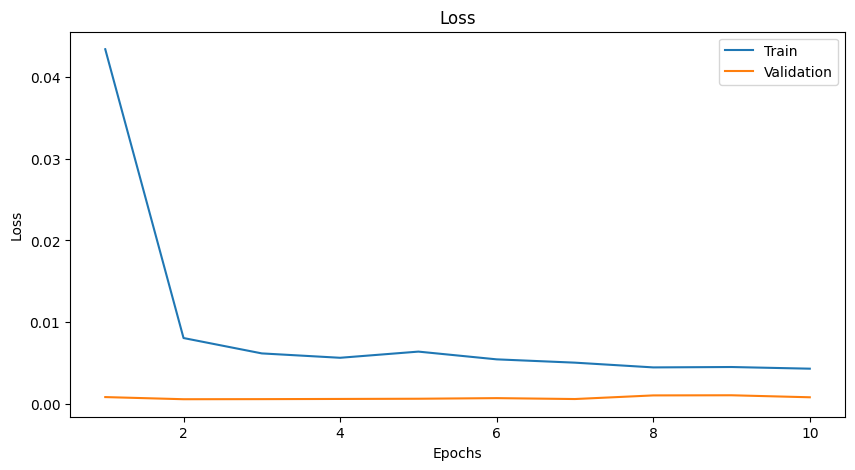

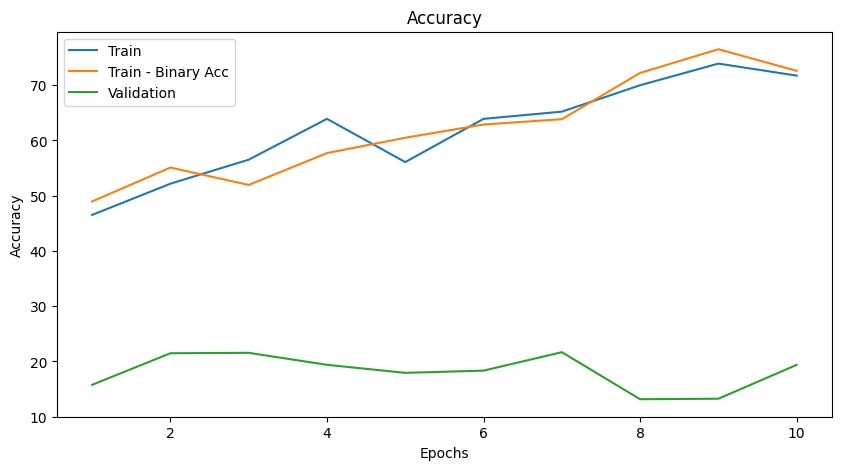

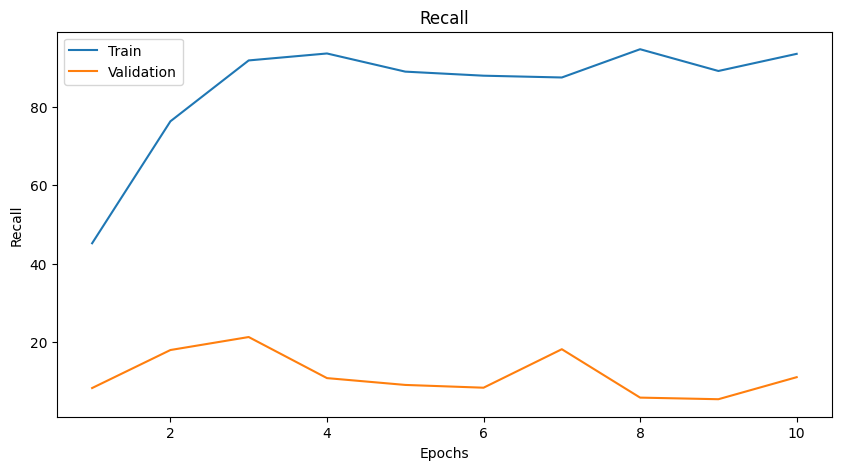

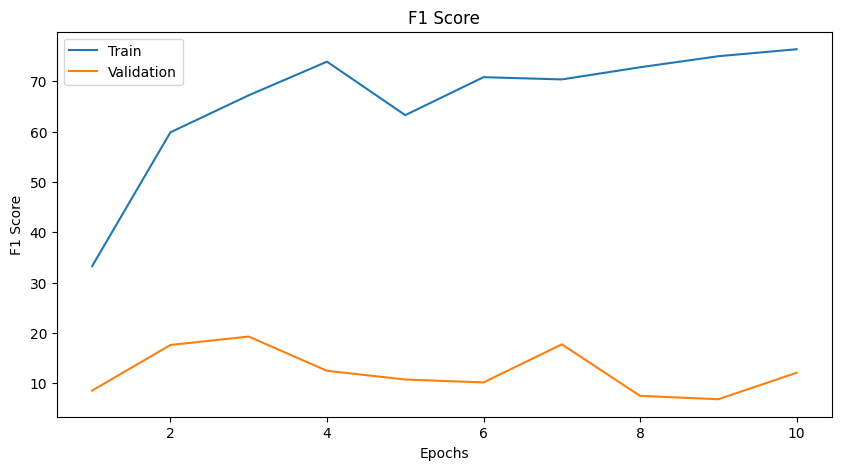

In [8]:
plot_metrics(train_losses, train_accuracies, train_accuracies_std, train_recalls, train_f1_scores,  valid_losses, valid_accuracies, valid_recalls, valid_f1_scores)

In [10]:
batch_size = 6

# Load best model saved on training
checkpoint = torch.load(ROOT_DIR + "/training_log/intr_output/loco/gen_calf_face/output_sub/best_checkpoint.pth", map_location='cpu')
# checkpoint = torch.load("output/mine/output_sub/checkpoint.pth", map_location='cpu')
model.load_state_dict(checkpoint['model'])

dataset_test = ImageDataset(valid_dataset, transform=test_transform)
sampler_test = torch.utils.data.SequentialSampler(dataset_test)
valid_loader = DataLoader(dataset_test, batch_size, sampler=sampler_test, drop_last=False, collate_fn=utils.collate_fn)
test_stats = evaluate(model, criterion, valid_loader, device, args.output_dir)

Test:  [0/3]  eta: 0:00:01  loss: 0.0985 (0.0985)  f1: 40.0000 (40.0000)  precision: 25.0000 (25.0000)  recall: 100.0000 (100.0000)  acc: 50.0000 (50.0000)  binary_acc: 70.0000 (70.0000)  time: 0.3769  data: 0.3586  max mem: 2228
Test:  [2/3]  eta: 0:00:00  loss: 0.0985 (0.1043)  f1: 50.0000 (56.6667)  precision: 40.0000 (43.8889)  recall: 100.0000 (88.8889)  acc: 50.0000 (52.7778)  binary_acc: 70.0000 (59.4444)  time: 0.3241  data: 0.3057  max mem: 2228
Test: Total time: 0:00:00 (0.3245 s / it)
Averaged stats: loss: 0.0985 (0.1043)  f1: 50.0000 (56.6667)  precision: 40.0000 (43.8889)  recall: 100.0000 (88.8889)  acc: 50.0000 (52.7778)  binary_acc: 70.0000 (59.4444)


## Visualisation

INTR interpretation visualization for loco
Species predicted by INTR is: Illness
Species class  is: Illness 



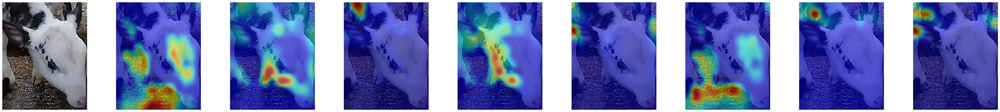




Test:  [ 0/16]  eta: 0:00:12    time: 0.8062  data: 0.0626  max mem: 2228
Species predicted by INTR is: Illness
Species class  is: Illness 



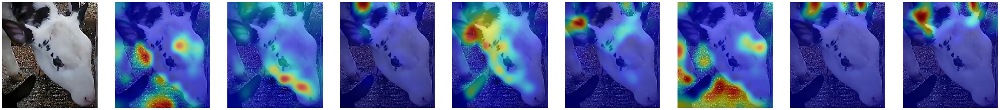




Test:  [ 1/16]  eta: 0:00:11    time: 0.7698  data: 0.0591  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Illness 



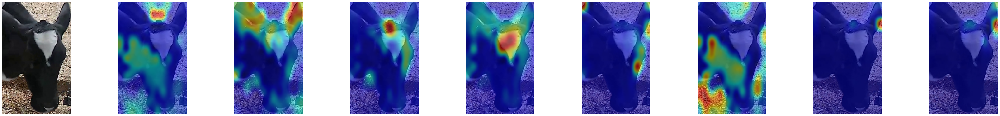




Test:  [ 2/16]  eta: 0:00:09    time: 0.7023  data: 0.0580  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Illness 



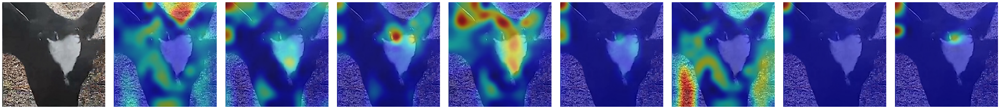




Test:  [ 3/16]  eta: 0:00:09    time: 0.6947  data: 0.0569  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Healthy 



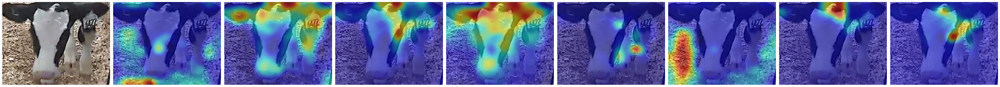




Test:  [ 4/16]  eta: 0:00:08    time: 0.6855  data: 0.0567  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Illness 



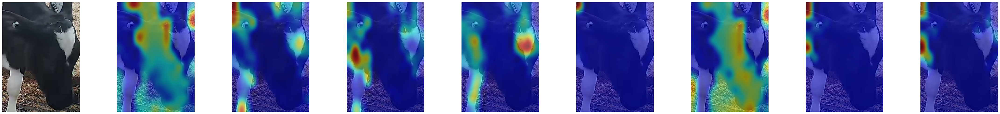




Test:  [ 5/16]  eta: 0:00:07    time: 0.6638  data: 0.0565  max mem: 2228
Species predicted by INTR is: Illness
Species class  is: Healthy 



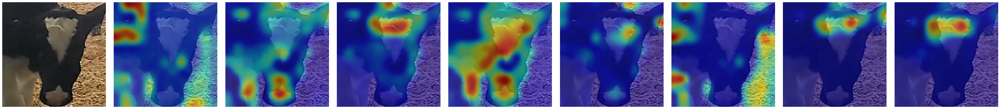




Test:  [ 6/16]  eta: 0:00:06    time: 0.6828  data: 0.0554  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Healthy 



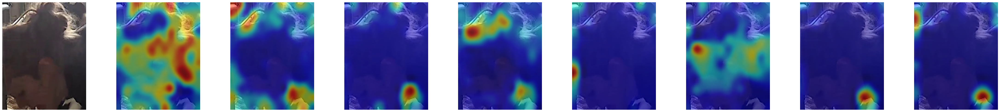




Test:  [ 7/16]  eta: 0:00:06    time: 0.6676  data: 0.0549  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Illness 



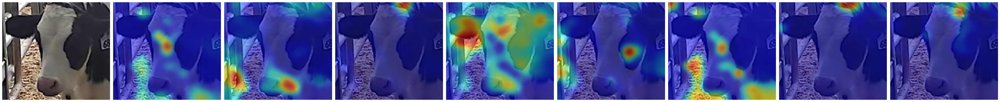




Test:  [ 8/16]  eta: 0:00:05    time: 0.6646  data: 0.0544  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Illness 



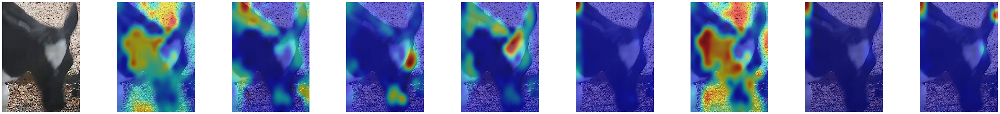




Test:  [ 9/16]  eta: 0:00:04    time: 0.6606  data: 0.0544  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Healthy 



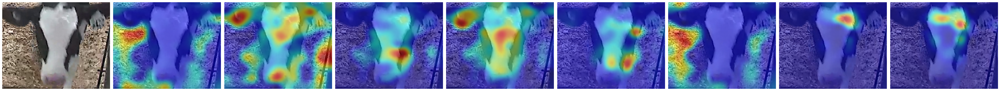




Test:  [10/16]  eta: 0:00:03    time: 0.6652  data: 0.0544  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Illness 



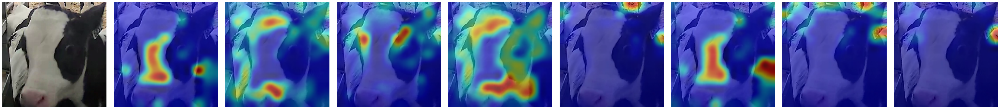




Test:  [11/16]  eta: 0:00:03    time: 0.6830  data: 0.0542  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Healthy 



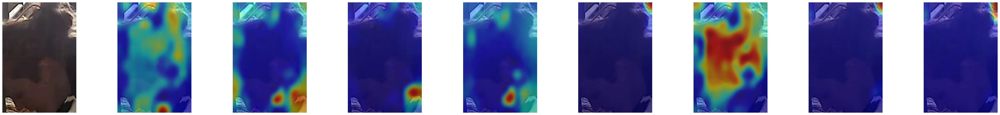




Test:  [12/16]  eta: 0:00:02    time: 0.6667  data: 0.0538  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Illness 



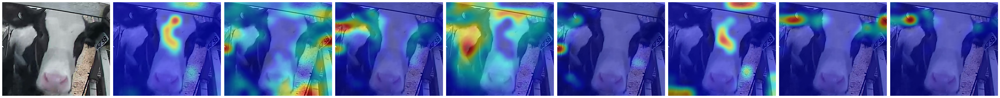




Test:  [13/16]  eta: 0:00:02    time: 0.6725  data: 0.0539  max mem: 2228
Species predicted by INTR is: Healthy
Species class  is: Healthy 



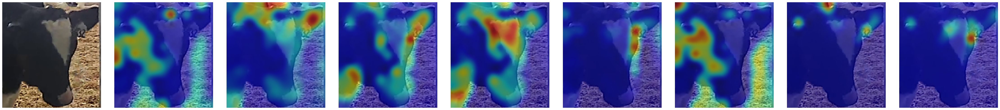




Test:  [14/16]  eta: 0:00:01    time: 0.6708  data: 0.0535  max mem: 2228
Species predicted by INTR is: Illness
Species class  is: Illness 



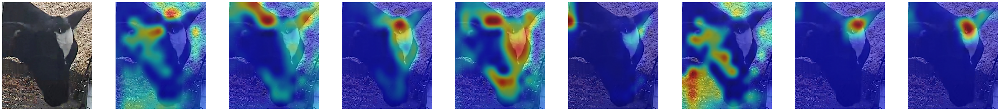




Test:  [15/16]  eta: 0:00:00    time: 0.6721  data: 0.0537  max mem: 2228
Test: Total time: 0:00:10 (0.6725 s / it)


In [11]:
batch_size = 1
args_parser = get_args_parser(epochs = epochs, batch_size = batch_size, num_labels=num_labels, rep = dataset_type, sampler = data_sampler)
parser = argparse.ArgumentParser('INTR interpretation visualization script', parents=[args_parser])
args = parser.parse_args(args=[])

# model, _ = build_model(args)
# model.to(device)
# model = load_model(args, model)
model.eval()

valid_loader = DataLoader(ImageDataset(valid_dataset, transform=None), batch_size=batch_size, shuffle=False)
metric_logger = utils.MetricLogger(delimiter="  ")
header = 'Test:'
print("INTR interpretation visualization for loco")
for samples, targets in metric_logger.log_every(valid_loader, 1, header):
    image = samples[0].cpu()
    samples = test_transform(samples)
    samples = samples.to(device)
    image_path = targets["file_name"][0][0]
    target_class = targets["image_label"][0][0]
    
    outputs, encoder_output, _, attention_scores, avg_attention_scores = model(samples)
    if args.num_queries > 1:
        pred_class=predicted_class(outputs, topk=(1, 1))
        pred_class_index = pred_class[0][0]
    else:
        pred_class=predicted_bin_class(outputs)
        pred_class_index = pred_class.item()
        
    print ("Species predicted by INTR is:", get_class_name(int(pred_class_index)))
    print ("Species class  is:", get_class_name(int(target_class)), "\n")

    if args.num_queries == 1:
        pred_class_index = 0

    visualization(args, image, int(pred_class_index), attention_scores, encoder_output)
    print("\n\n")